<a href="https://colab.research.google.com/github/TingAnWang/colorization-with-Conditional-GAN/blob/main/intro_to_cs_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### 1.1- Prepare Colab to run the code

In [1]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [2]:
!pip install fastai --upgrade

The following will download about 20,000 images from COCO dataset. Notice that **we are going to use only 8000 of them** for training. Also you can use any other dataset like ImageNet as long as it contains various scenes and locations.

In [3]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

<!-- 1. save 5 images to a variable ('/root/.fastai/data/coco_sample/train_sample/000000198137.jpg' , '/root/.fastai/data/coco_sample/train_sample/000000198137.jpg' -->
<!-- 2. remain all the code except train_model function -->
1. In the train_model func, modify _ _ (load the variable e.g. images_folder) so we can feed graylish images to our moedel and output the colorized images.

In [4]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"

paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names

train_paths = paths[:8000]
val_paths = paths[8000:10000]

print(paths)
print(len(train_paths), len(val_paths))

['/root/.fastai/data/coco_sample/train_sample/000000306581.jpg', '/root/.fastai/data/coco_sample/train_sample/000000102987.jpg', '/root/.fastai/data/coco_sample/train_sample/000000075527.jpg', '/root/.fastai/data/coco_sample/train_sample/000000426118.jpg', '/root/.fastai/data/coco_sample/train_sample/000000437857.jpg', '/root/.fastai/data/coco_sample/train_sample/000000146614.jpg', '/root/.fastai/data/coco_sample/train_sample/000000258859.jpg', '/root/.fastai/data/coco_sample/train_sample/000000474049.jpg', '/root/.fastai/data/coco_sample/train_sample/000000451522.jpg', '/root/.fastai/data/coco_sample/train_sample/000000468276.jpg', '/root/.fastai/data/coco_sample/train_sample/000000138494.jpg', '/root/.fastai/data/coco_sample/train_sample/000000365282.jpg', '/root/.fastai/data/coco_sample/train_sample/000000346774.jpg', '/root/.fastai/data/coco_sample/train_sample/000000346049.jpg', '/root/.fastai/data/coco_sample/train_sample/000000400039.jpg', '/root/.fastai/data/coco_sample/train_s

Although we are using the same dataset and number of training samples, the exact 8000 images that you train your model on may vary (although we are seeding!) because the dataset here has only 20000 images with different ordering while I sampled 10000 images from the complete dataset.

### 1.2- Making Datasets and DataLoaders

In [5]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [6]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')
print("train_dl:")
print(train_dl)
print()
data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

train_dl:



/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
500 125


### 1.3- Generator proposed by the paper

In [7]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)

        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        return self.model(x)

### 1.4- Discriminator

In [8]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2)
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

Let's take a look at its blocks:

In [ ]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

And its output shape:

In [9]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

### 1.5- GAN Loss

In [10]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

### 1.x Model Initialization

In [11]:
def init_weights(net, init='norm', gain=0.02):

    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

### 1.6- Putting everything together

In [12]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4,
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)

    def forward(self):
        self.fake_color = self.net_G(self.L)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()

        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

### 1.xx Utility functions

In [13]:
class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()

    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")

def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

### 1.7- Training function
If you download the res34-unet pt file, then you don't need to run this block.

In [14]:
def train_model(model, train_dl, epochs, display_every=200):
    for e in range(epochs):
        loss_meter_dict = create_loss_meters()  # function returning a dictionary of objects to log the losses of the complete network
        i = 0  # Counter for iterations

        for data_batch in tqdm(train_dl):
            model.setup_input(data_batch)
            model.optimize()
            update_losses(model, loss_meter_dict, count=data_batch['L'].size(0))  # function updating the log objects
            i += 1

            if i % display_every == 0:
                print(f"\nEpoch {e + 1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict)  # function to print out the losses
                visualize(model, data_batch, save=False)  # function displaying the model's outputs

              # At the end of the last epoch, save the images separately
        # if e == epochs - 1:
        #       save_images_separately(model, data_batch, save_images_folder)


# model = MainModel()
# # train_model(model, train_dl, 100)
# train_model(model, train_dl, 20, "G_not_pretrained_vanilla")

### 1.8- Save image
The function written below is used for saving the colorized image

In [15]:
def save_images_separately(model, data, save_folder):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    # os.makedirs(save_folder, exist_ok=True)

    # Save Grayscale, Fake Colorized, and Real Color images separately
    # print(L.shape) # torch.Size([16, 1, 256, 256])
    save_images(L[:, 0].cpu().numpy(), "grayscale", save_folder)
    save_images(fake_imgs, "fake_colorized", save_folder)
    save_images(real_imgs, "real_colorized", save_folder)

def save_images(images, prefix, folder):
    os.makedirs(folder, exist_ok=True)  # Create the folder if it doesn't exist
    print(len(images))
    for i, image in enumerate(images):
      filename = os.path.join(folder, f"{prefix}_{i}_{time.time()}.png")
      plt.imsave(filename, image)
      break

Every epoch takes about 3 to 4 minutes on Colab. After about 20 epochs you should see some reasonable results.

## 2- A new strategy - the final model

### 2.1- Using a new generator

In [16]:
# pip install fastai==2.4
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from torchvision.models.resnet import resnet34
from fastai.vision.models.unet import DynamicUnet

In [ ]:

# def build_res_unet(n_input=1, n_output=2, size=256):
#     device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#     model = resnet18(pretrained=True)
#     body = create_body(model, pretrained=True, n_in=n_input, cut=-2)
#     net_G = DynamicUnet(body, n_output, (size, size)).to(device)
#     return net_G

### 2.2 Pretraining the generator for colorization task

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()

            loss_meter.update(loss.item(), L.size(0))

        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

# net_G = build_res_unet(n_input=1, n_output=2, size=256)
# opt = optim.Adam(net_G.parameters(), lr=1e-4)
# criterion = nn.L1Loss()
# pretrain_generator(net_G, train_dl, opt, criterion, 20)
# torch.save(net_G.state_dict(), "res18-unet.pt")

In [ ]:
# Build res18-unet and save it as pt file.
# net_G = build_res_unet(n_input=1, n_output=2, size=256)
# opt = optim.Adam(net_G.parameters(), lr=1e-4)
# criterion = nn.L1Loss()
# pretrain_generator(net_G, train_dl, opt, criterion, 20)
# torch.save(net_G.state_dict(), "res18-unet.pt")

### 2.3 Putting everything together, again!

In [ ]:
# net_G = build_res_unet(n_input=1, n_output=2, size=256)
# net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
# model = MainModel(net_G=net_G)
# train_model(model, train_dl, 1, "res18_result")
# torch.save(model.state_dict(), "finetuned.pt")

In [17]:
!gdown --id 1ibAx6uQXPDz9v3MjAB2RI3_ksPV7MUaE # download res34-unet.pt

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1ibAx6uQXPDz9v3MjAB2RI3_ksPV7MUaE
To: /content/res34-unet.pt
100% 165M/165M [00:02<00:00, 58.3MB/s]


In [18]:
!gdown --id 1Gu8ZZ2V8HTi_QhD6LqkrG1VZDBo7Eir- #download final.pt

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1Gu8ZZ2V8HTi_QhD6LqkrG1VZDBo7Eir-
To: /content/final.pt
100% 176M/176M [00:02<00:00, 83.2MB/s]


In [19]:
!gdown --id 1snnQG6fyjeHvt0lPP5L7miqfDHfEe2uc # download final_v2.pt (res34-unet for 40 epochs)

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1snnQG6fyjeHvt0lPP5L7miqfDHfEe2uc
To: /content/final_v2.pt
100% 176M/176M [00:03<00:00, 44.3MB/s]


In [20]:
!gdown --id 1EwrUrUQ5ucAckbpzBc3l8vR6yrWUEY2L # download final_v3.pt (res34-unet for 60 epochs)

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1EwrUrUQ5ucAckbpzBc3l8vR6yrWUEY2L
To: /content/final_v3.pt
100% 176M/176M [00:04<00:00, 43.1MB/s]


In [21]:
def visualize_model(model, train_dl, save_images_folder, display_every=200):
      i = 0
      for data in tqdm(train_dl):
          i += 1
          if i % display_every == 0:
              print(f"Iteration {i}/{len(train_dl)}")
              # visualize(model, data, save=False) # function displaying the model's outputs
      save_images_separately(model, data, save_images_folder)

Load and initialize res18-unet model

In [ ]:
# net_G = build_res_unet(n_input=1, n_output=2, size=256)
# net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
# model = MainModel(net_G=net_G)
# model.load_state_dict(torch.load("final_model_weights.pt", map_location=device))
# visualize_model(model, train_dl, 'G_pretrained_res18_result')


Build res34-unet model

In [22]:
def build_res_unet_34(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = resnet34(pretrained=True)
    body = create_body(model, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

Save res34-unet model in the form of pt file

In [23]:
# save res34 pt model
net_G = build_res_unet_34(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()
pretrain_generator(net_G, train_dl, opt, criterion, 20)
torch.save(net_G.state_dict(), "res34-unet.pt")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
 66%|██████▌   | 54.8M/83.3M [00:00<00:00, 80.6MB/s]


KeyboardInterrupt: ignored

In [ ]:
# !gdown --id 1lR6DcS4m5InSbZ5y59zkH2mHt_4RQ2KV

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1lR6DcS4m5InSbZ5y59zkH2mHt_4RQ2KV
To: /content/final_model_weights.pt
100% 136M/136M [00:01<00:00, 122MB/s]


Load the pretrained res34-unet.pt and use it to train the model for 20 epochs.

In [ ]:
from google.colab import files

net_G = build_res_unet_34(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res34-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
# torch.save(model.state_dict(), "test.pt")

train_model(model, train_dl, 40)
torch.save(model.state_dict(), "final_v2.pt")

files.download('final_v2.pt')

model initialized with norm initialization


  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/20
Iteration 200/500
loss_D_fake: 0.61651
loss_D_real: 0.62507
loss_D: 0.62079
loss_G_GAN: 0.96521
loss_G_L1: 5.59290
loss_G: 6.55810


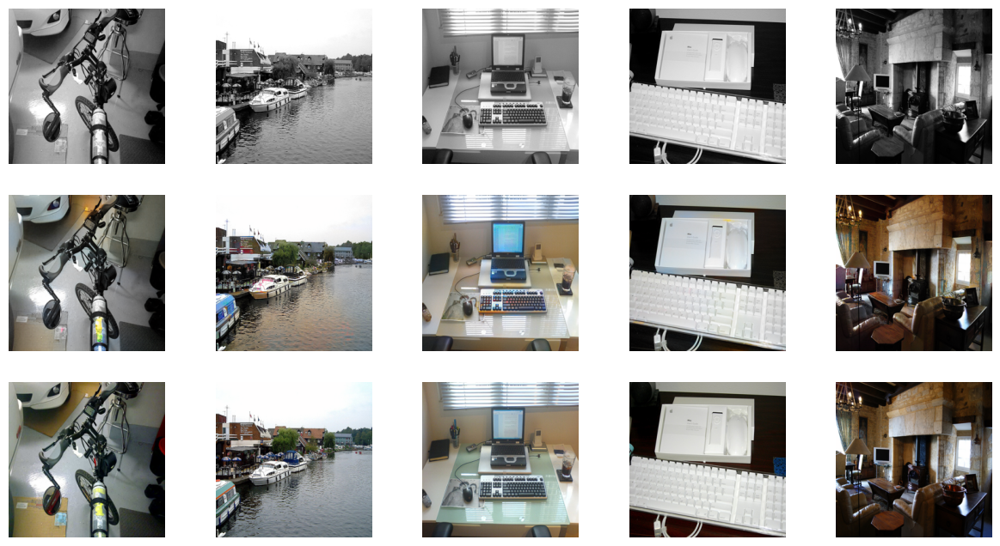


Epoch 1/20
Iteration 400/500
loss_D_fake: 0.61325
loss_D_real: 0.62245
loss_D: 0.61785
loss_G_GAN: 0.96173
loss_G_L1: 5.59400
loss_G: 6.55573


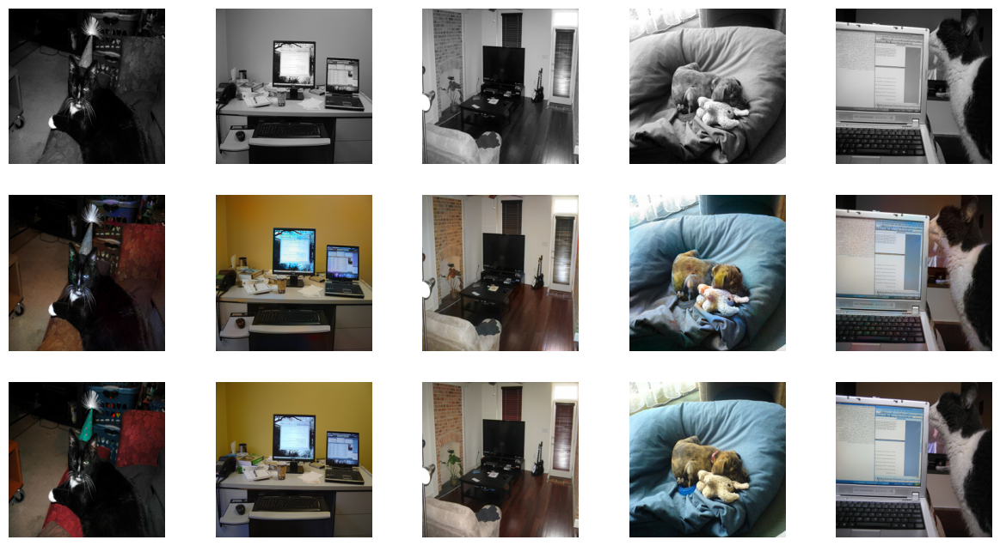

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/20
Iteration 200/500
loss_D_fake: 0.61569
loss_D_real: 0.62341
loss_D: 0.61955
loss_G_GAN: 0.97047
loss_G_L1: 5.51197
loss_G: 6.48244


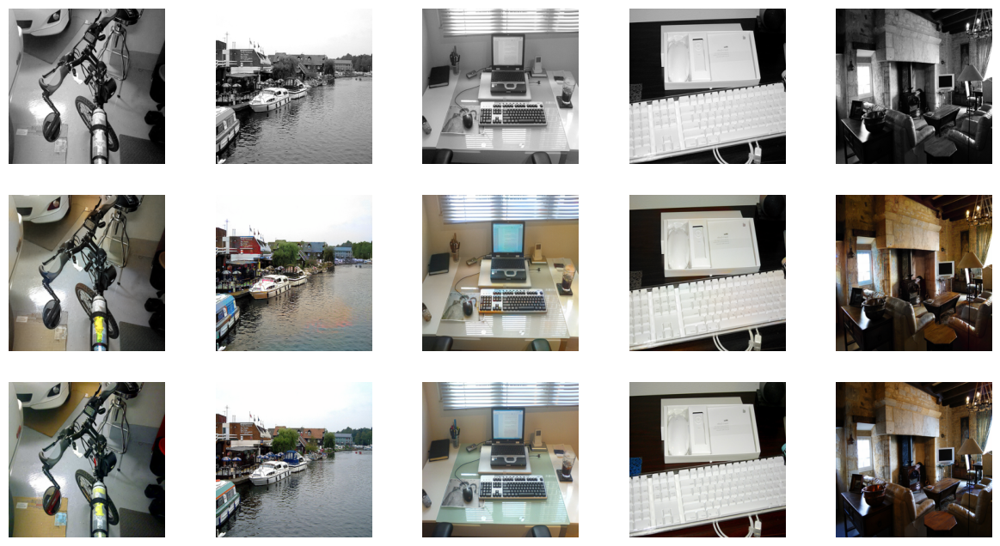


Epoch 2/20
Iteration 400/500
loss_D_fake: 0.62374
loss_D_real: 0.63261
loss_D: 0.62818
loss_G_GAN: 0.98016
loss_G_L1: 5.52030
loss_G: 6.50047


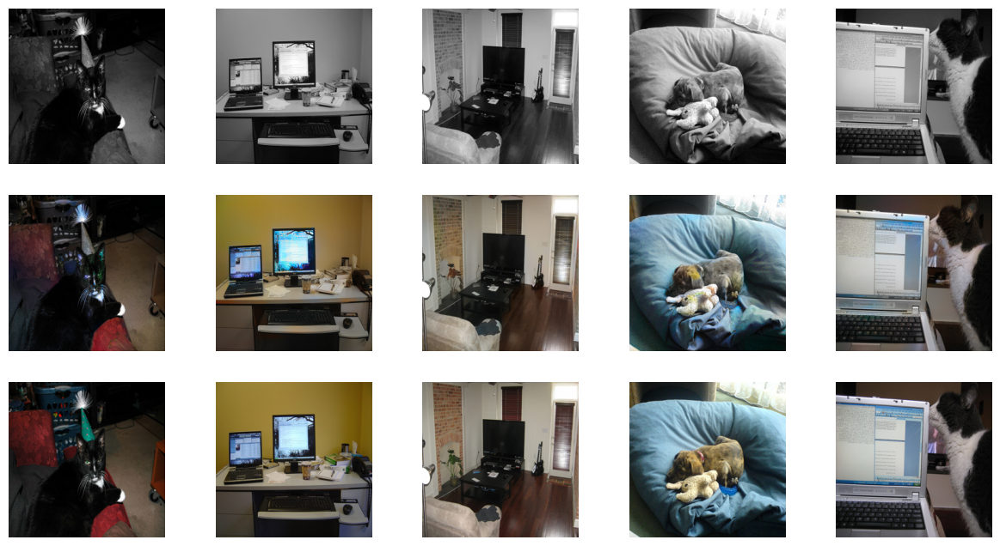

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/20
Iteration 200/500
loss_D_fake: 0.60639
loss_D_real: 0.61723
loss_D: 0.61181
loss_G_GAN: 0.94828
loss_G_L1: 5.45501
loss_G: 6.40329


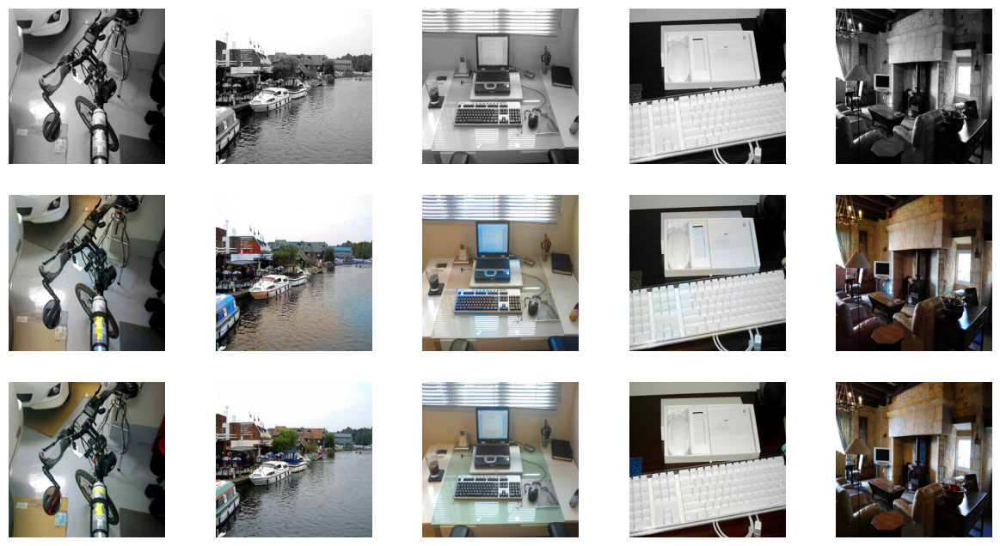


Epoch 3/20
Iteration 400/500
loss_D_fake: 0.60554
loss_D_real: 0.61728
loss_D: 0.61141
loss_G_GAN: 0.94959
loss_G_L1: 5.45565
loss_G: 6.40525


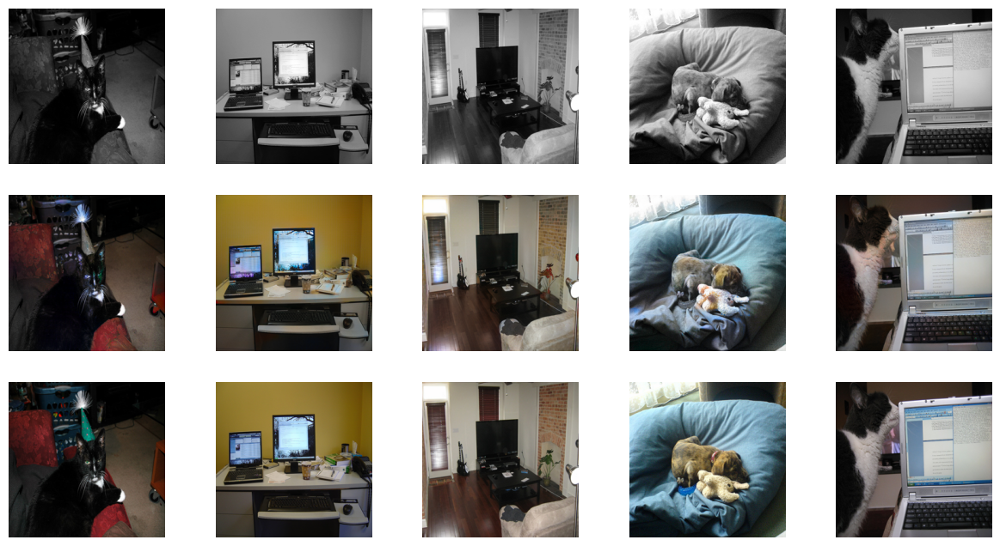

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/20
Iteration 200/500
loss_D_fake: 0.61067
loss_D_real: 0.61954
loss_D: 0.61511
loss_G_GAN: 0.96247
loss_G_L1: 5.39168
loss_G: 6.35415


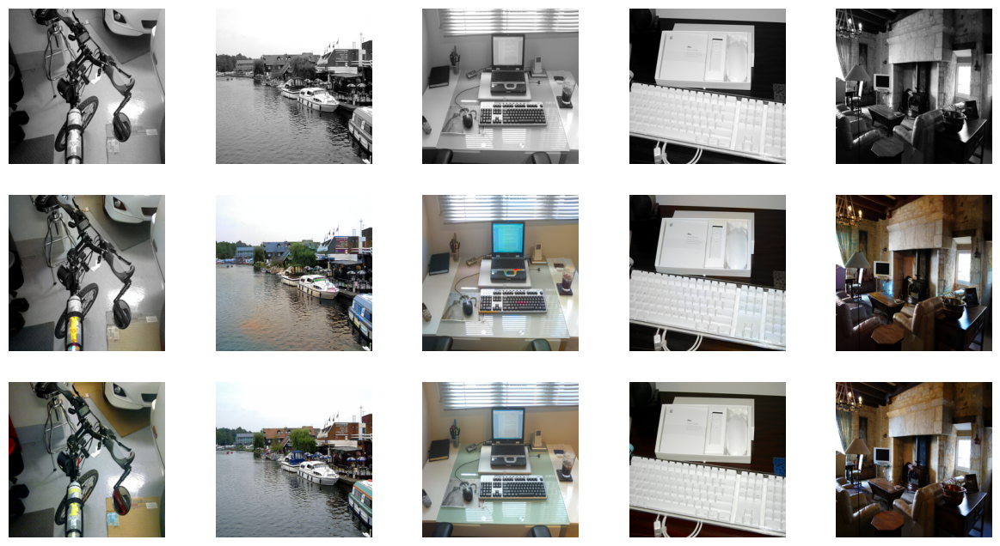


Epoch 4/20
Iteration 400/500
loss_D_fake: 0.61018
loss_D_real: 0.61948
loss_D: 0.61483
loss_G_GAN: 0.95924
loss_G_L1: 5.38267
loss_G: 6.34190


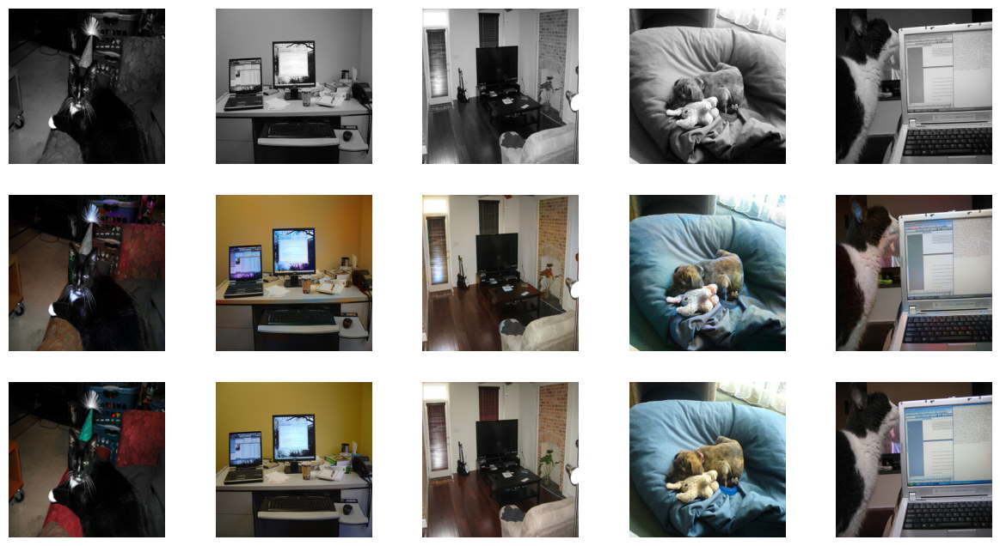

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/20
Iteration 200/500
loss_D_fake: 0.61403
loss_D_real: 0.62372
loss_D: 0.61888
loss_G_GAN: 0.96617
loss_G_L1: 5.31822
loss_G: 6.28438


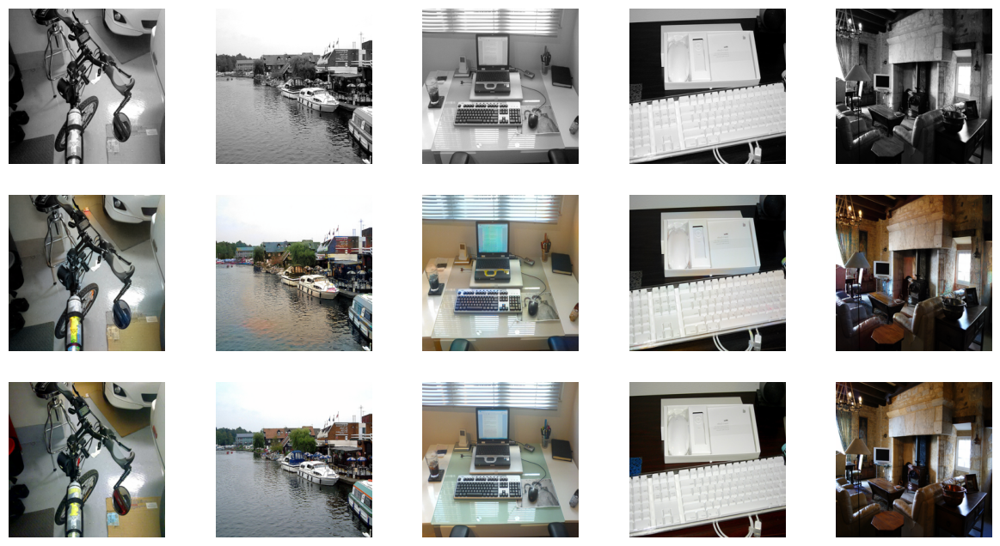


Epoch 5/20
Iteration 400/500
loss_D_fake: 0.61355
loss_D_real: 0.62250
loss_D: 0.61802
loss_G_GAN: 0.96407
loss_G_L1: 5.31746
loss_G: 6.28154


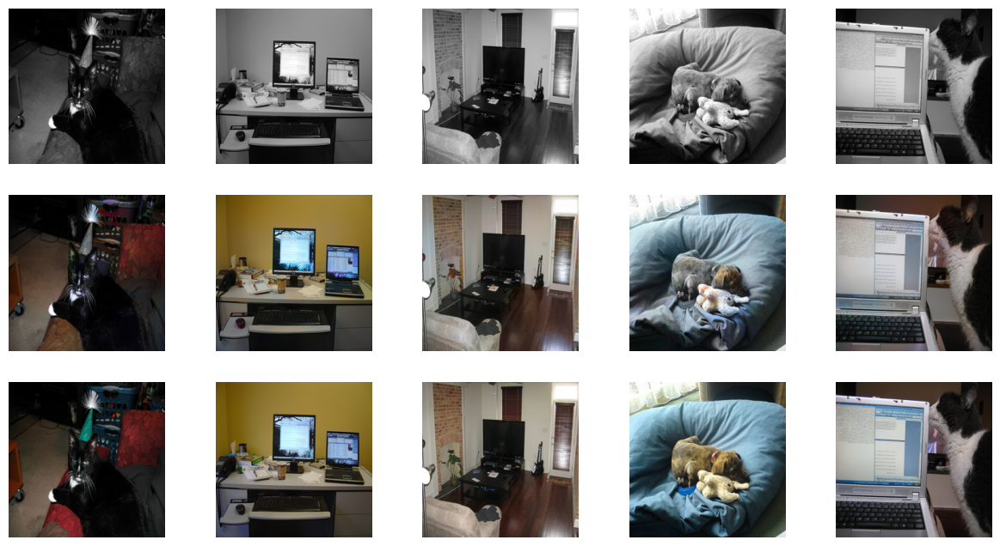

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/20
Iteration 200/500
loss_D_fake: 0.61693
loss_D_real: 0.62512
loss_D: 0.62102
loss_G_GAN: 0.96833
loss_G_L1: 5.26670
loss_G: 6.23504


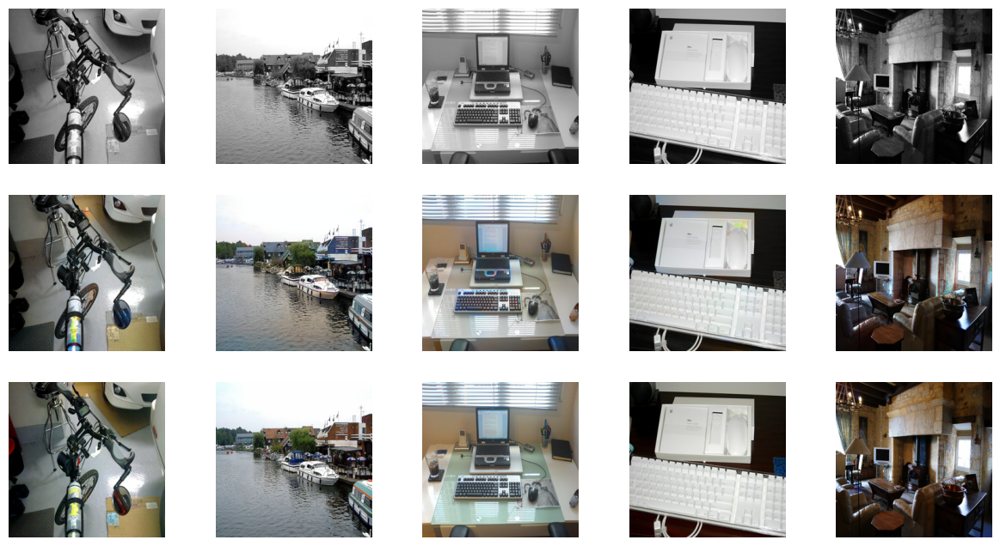


Epoch 6/20
Iteration 400/500
loss_D_fake: 0.61562
loss_D_real: 0.62210
loss_D: 0.61886
loss_G_GAN: 0.96499
loss_G_L1: 5.25771
loss_G: 6.22270


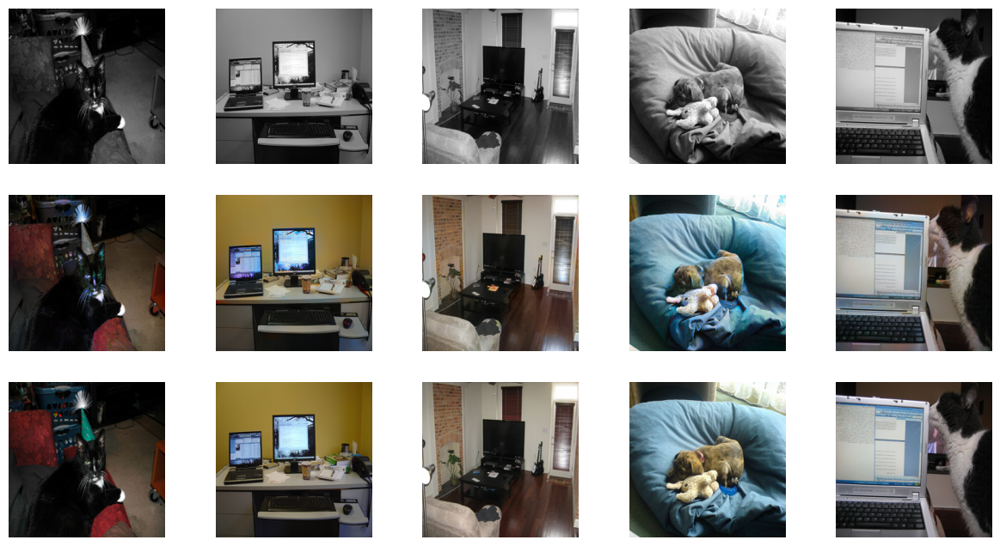

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/20
Iteration 200/500
loss_D_fake: 0.61756
loss_D_real: 0.62517
loss_D: 0.62137
loss_G_GAN: 0.97060
loss_G_L1: 5.17197
loss_G: 6.14257


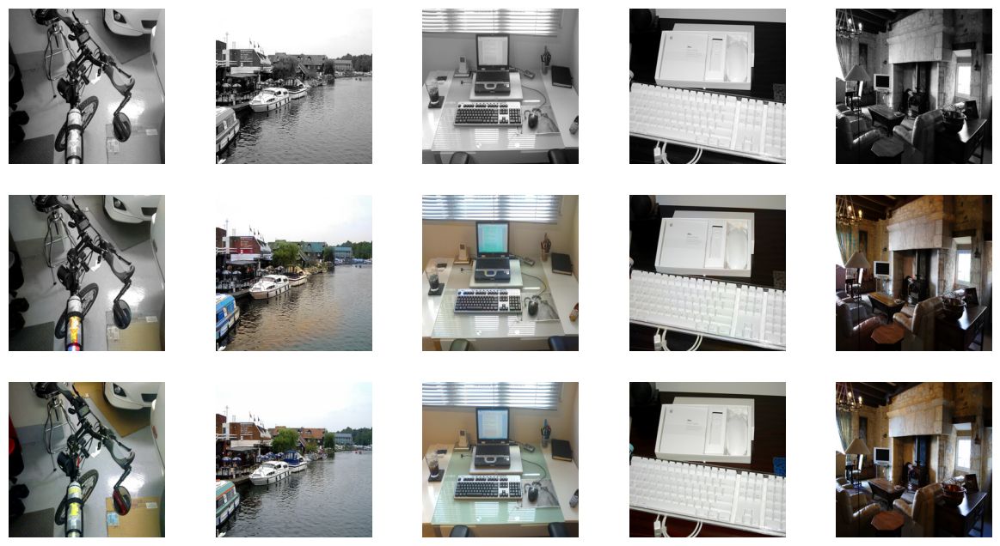


Epoch 7/20
Iteration 400/500
loss_D_fake: 0.61546
loss_D_real: 0.62274
loss_D: 0.61910
loss_G_GAN: 0.96659
loss_G_L1: 5.16902
loss_G: 6.13562


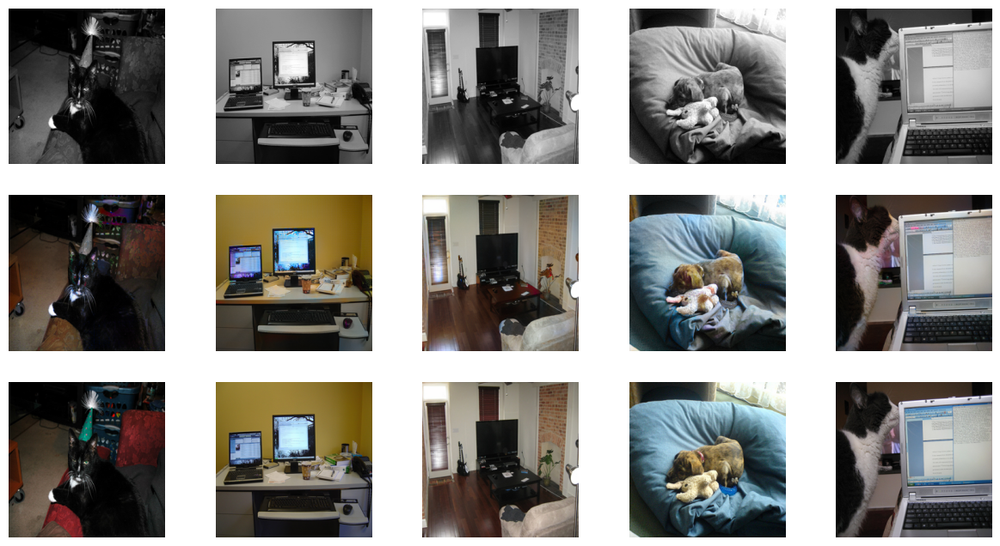

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/20
Iteration 200/500
loss_D_fake: 0.61819
loss_D_real: 0.62467
loss_D: 0.62143
loss_G_GAN: 0.96491
loss_G_L1: 5.10736
loss_G: 6.07228


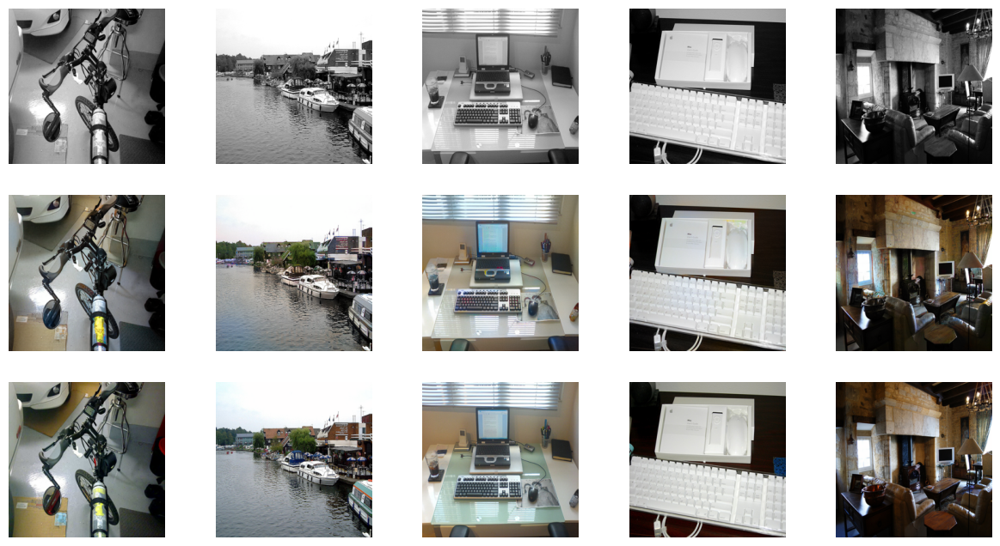


Epoch 8/20
Iteration 400/500
loss_D_fake: 0.61640
loss_D_real: 0.62493
loss_D: 0.62066
loss_G_GAN: 0.96132
loss_G_L1: 5.10883
loss_G: 6.07015


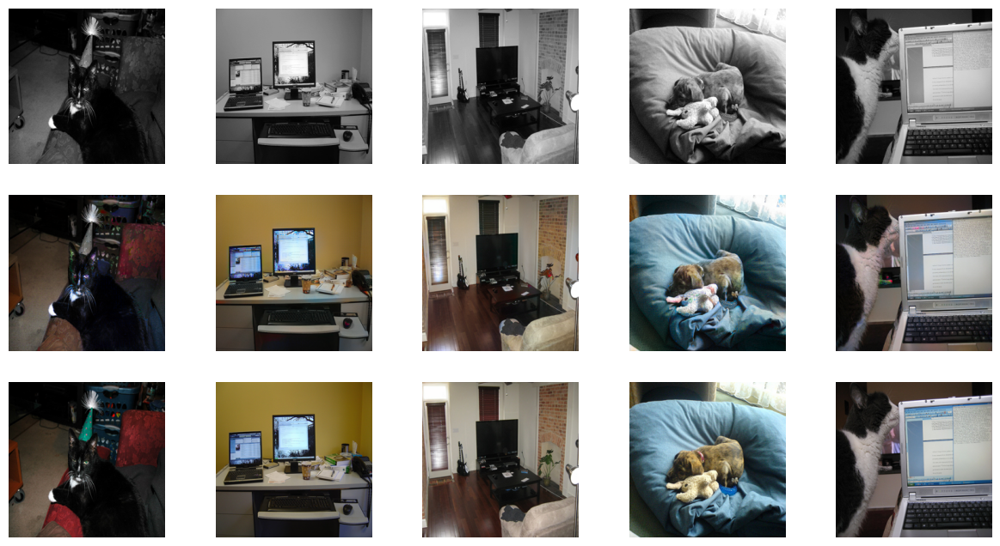

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/20
Iteration 200/500
loss_D_fake: 0.61758
loss_D_real: 0.62391
loss_D: 0.62074
loss_G_GAN: 0.96785
loss_G_L1: 5.08070
loss_G: 6.04855


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)


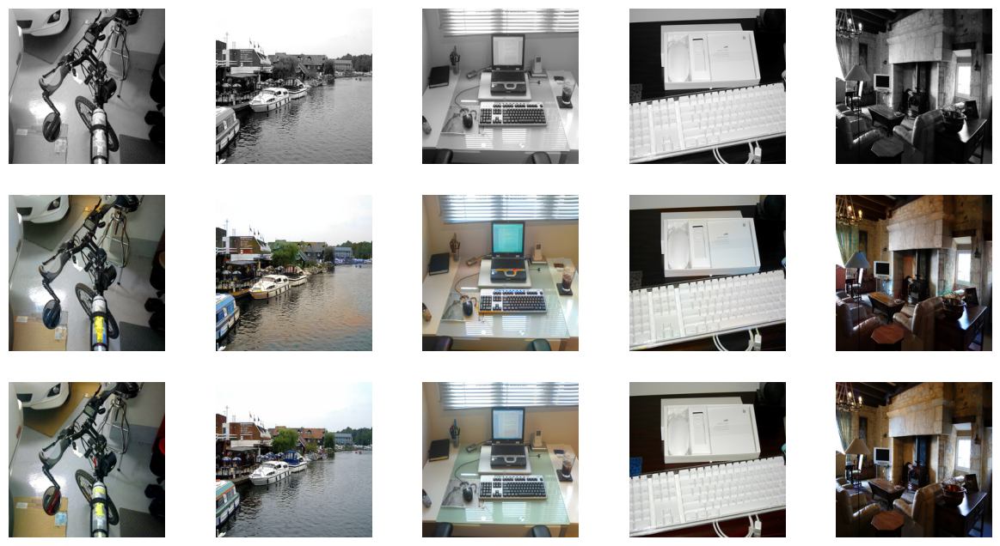


Epoch 9/20
Iteration 400/500
loss_D_fake: 0.61572
loss_D_real: 0.62242
loss_D: 0.61907
loss_G_GAN: 0.96514
loss_G_L1: 5.06807
loss_G: 6.03322


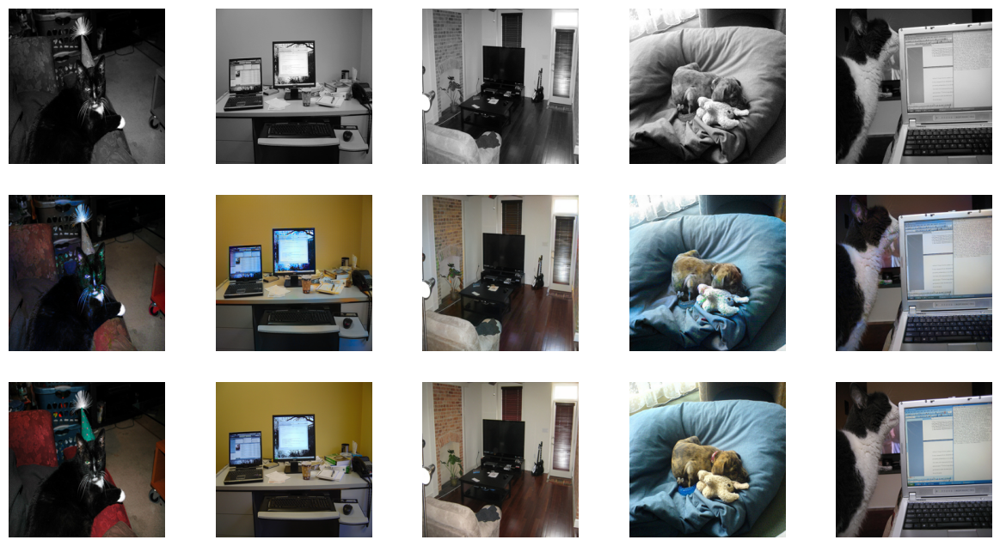

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/20
Iteration 200/500
loss_D_fake: 0.61534
loss_D_real: 0.61968
loss_D: 0.61751
loss_G_GAN: 0.96609
loss_G_L1: 5.01715
loss_G: 5.98324


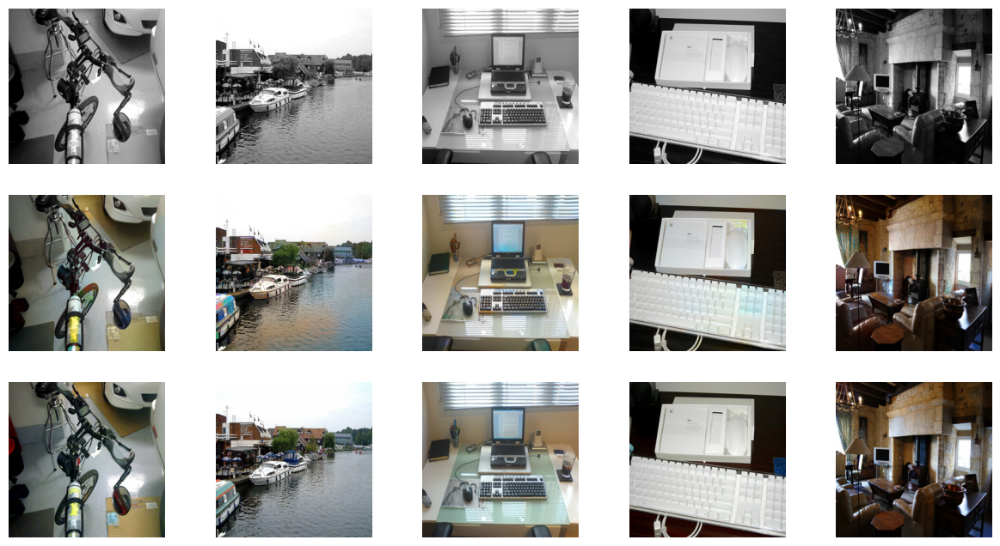


Epoch 10/20
Iteration 400/500
loss_D_fake: 0.61461
loss_D_real: 0.62140
loss_D: 0.61800
loss_G_GAN: 0.96424
loss_G_L1: 5.00725
loss_G: 5.97149


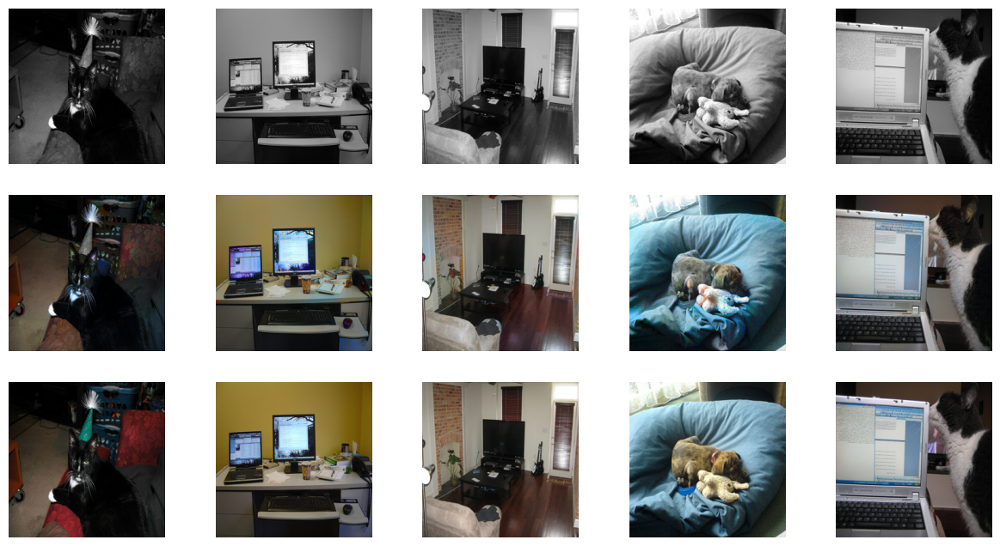

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/20
Iteration 200/500
loss_D_fake: 0.68822
loss_D_real: 0.69609
loss_D: 0.69216
loss_G_GAN: 1.03368
loss_G_L1: 4.95464
loss_G: 5.98832


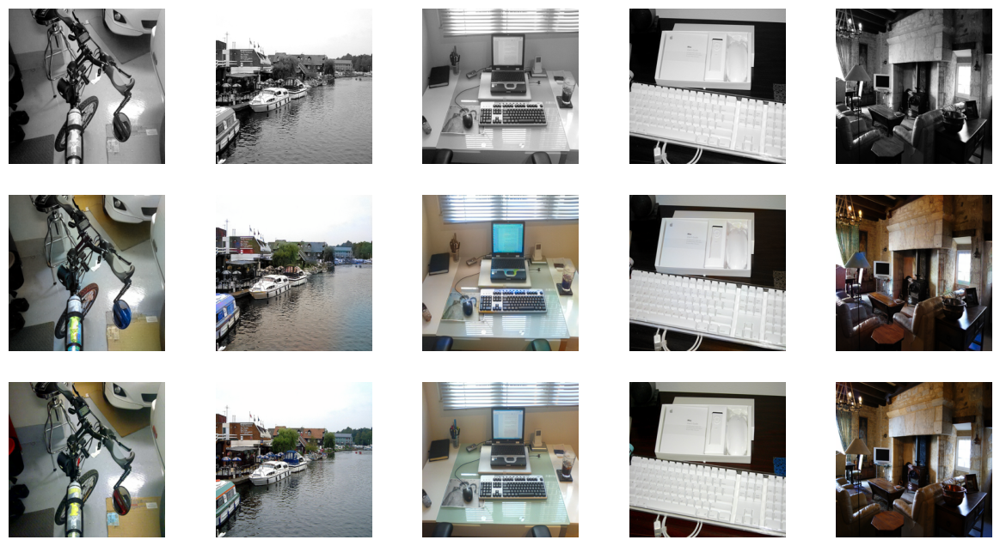


Epoch 11/20
Iteration 400/500
loss_D_fake: 0.65107
loss_D_real: 0.65708
loss_D: 0.65407
loss_G_GAN: 0.97269
loss_G_L1: 4.93601
loss_G: 5.90869


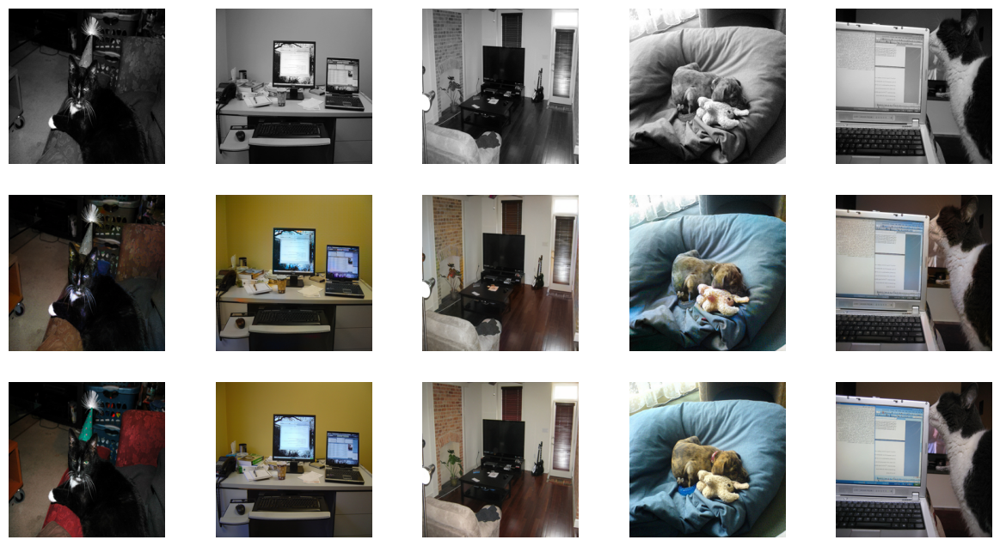

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/20
Iteration 200/500
loss_D_fake: 0.61050
loss_D_real: 0.61553
loss_D: 0.61302
loss_G_GAN: 0.94952
loss_G_L1: 4.88541
loss_G: 5.83493


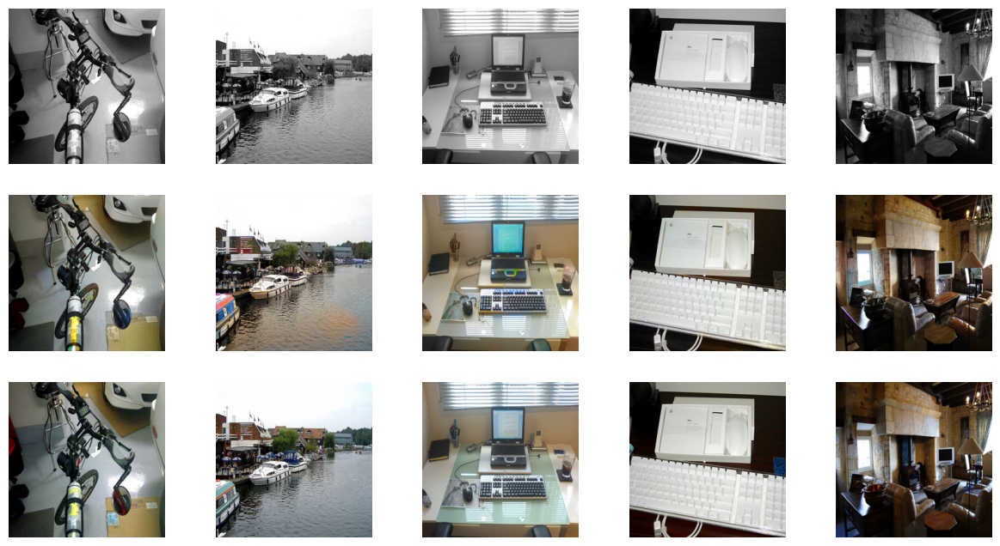


Epoch 12/20
Iteration 400/500
loss_D_fake: 0.61009
loss_D_real: 0.61551
loss_D: 0.61280
loss_G_GAN: 0.94796
loss_G_L1: 4.90026
loss_G: 5.84822


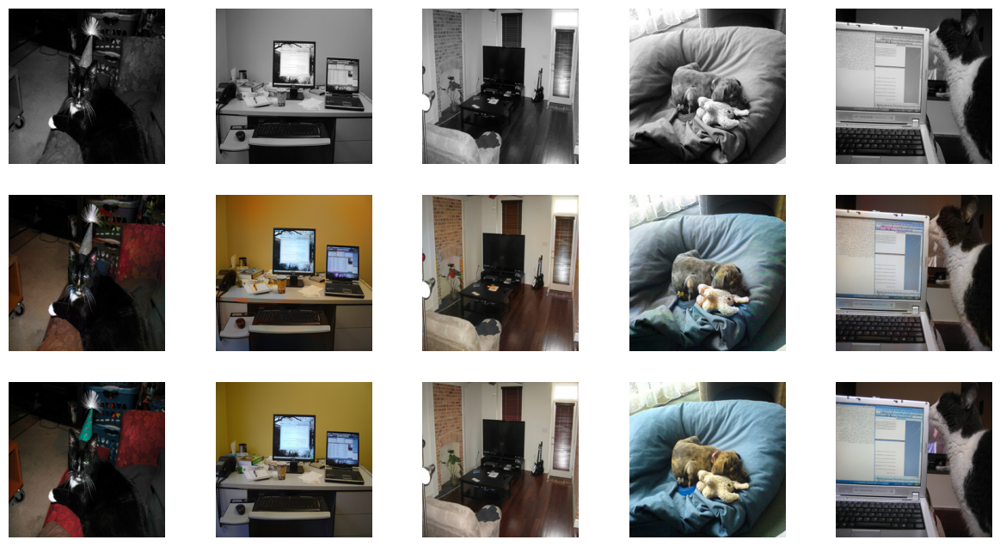

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/20
Iteration 200/500
loss_D_fake: 0.61617
loss_D_real: 0.62048
loss_D: 0.61832
loss_G_GAN: 0.95845
loss_G_L1: 4.84742
loss_G: 5.80587


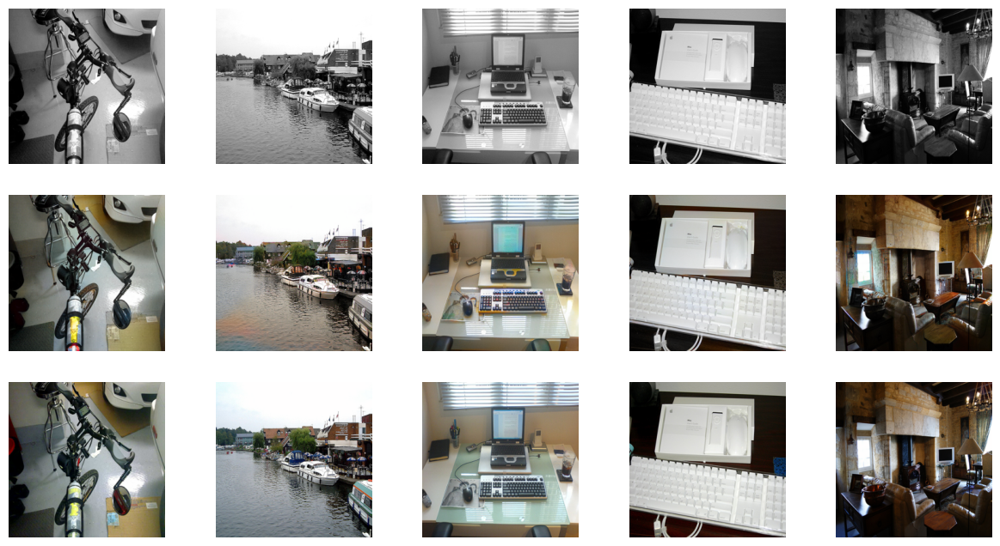


Epoch 13/20
Iteration 400/500
loss_D_fake: 0.61541
loss_D_real: 0.62017
loss_D: 0.61779
loss_G_GAN: 0.95720
loss_G_L1: 4.85036
loss_G: 5.80756


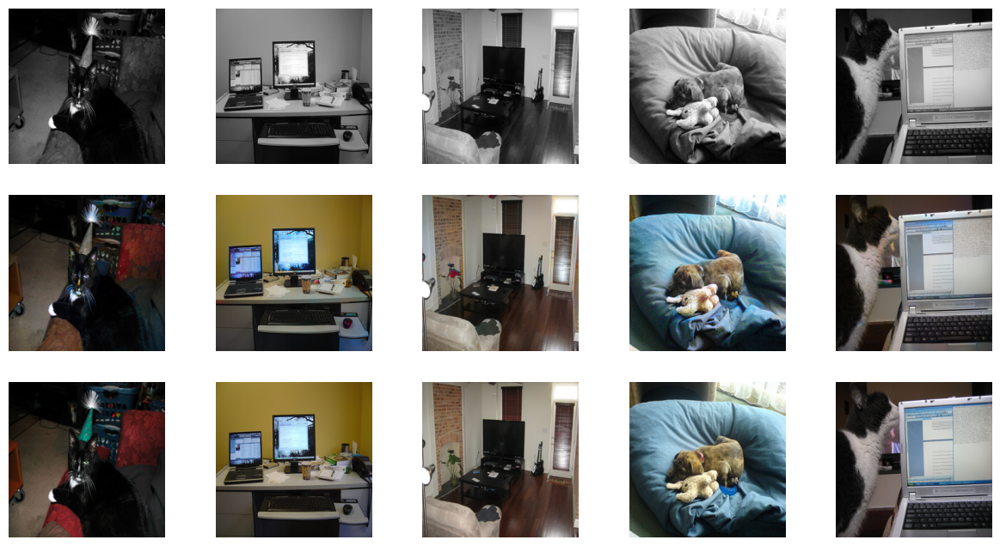

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/20
Iteration 200/500
loss_D_fake: 0.62050
loss_D_real: 0.62572
loss_D: 0.62311
loss_G_GAN: 0.96750
loss_G_L1: 4.80711
loss_G: 5.77461


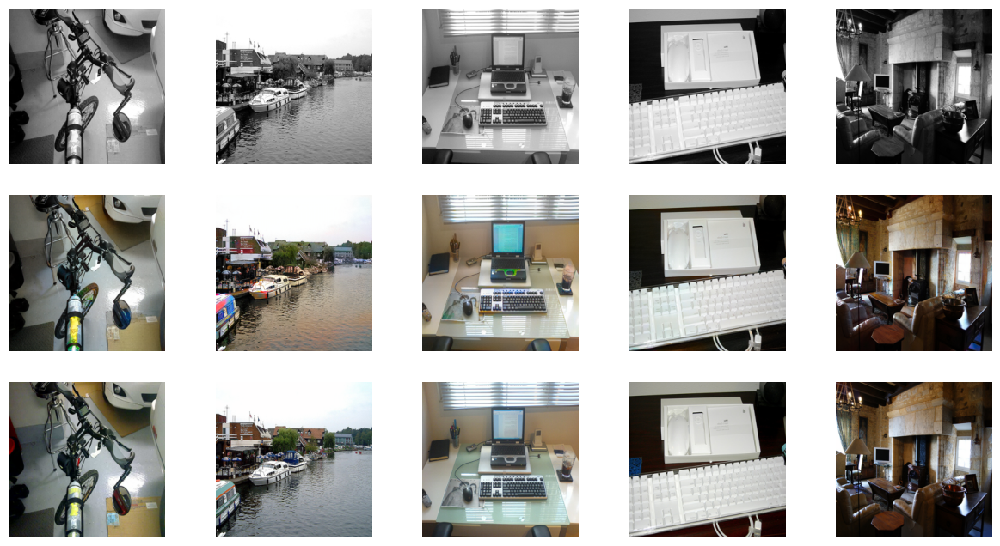


Epoch 14/20
Iteration 400/500
loss_D_fake: 0.61998
loss_D_real: 0.62364
loss_D: 0.62181
loss_G_GAN: 0.96017
loss_G_L1: 4.81095
loss_G: 5.77112


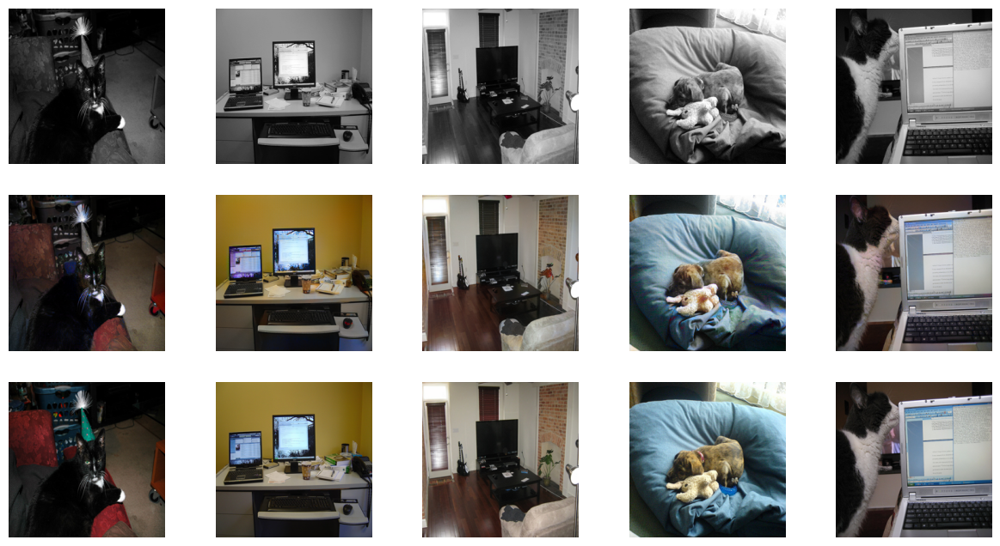

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 15/20
Iteration 200/500
loss_D_fake: 0.61795
loss_D_real: 0.61948
loss_D: 0.61872
loss_G_GAN: 0.96767
loss_G_L1: 4.78280
loss_G: 5.75047


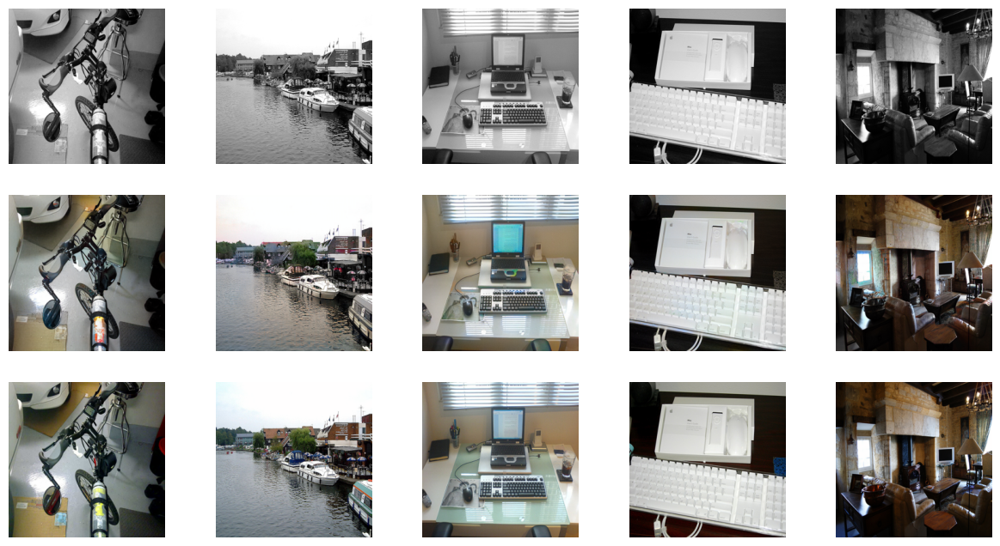


Epoch 15/20
Iteration 400/500
loss_D_fake: 0.61728
loss_D_real: 0.62075
loss_D: 0.61902
loss_G_GAN: 0.96348
loss_G_L1: 4.78368
loss_G: 5.74716


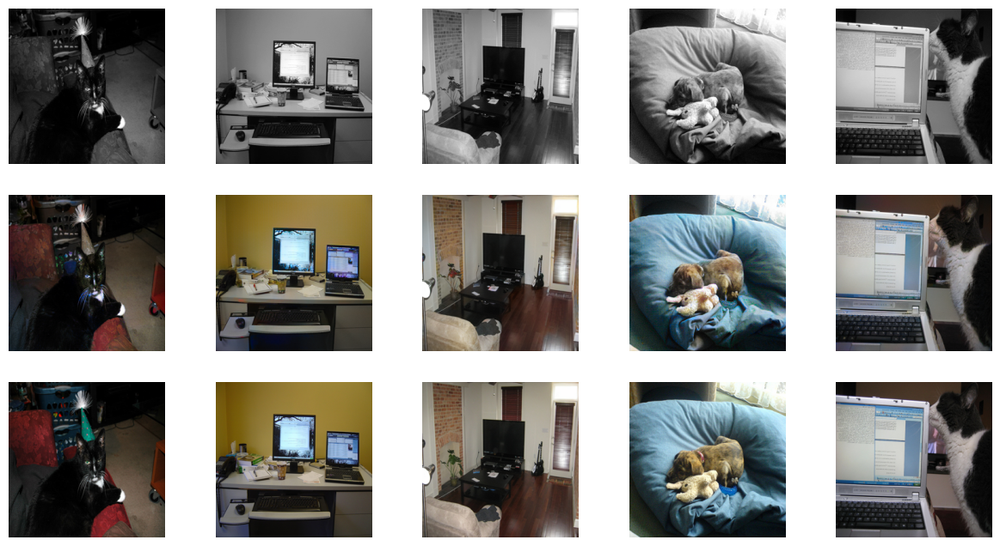

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 16/20
Iteration 200/500
loss_D_fake: 0.62162
loss_D_real: 0.62524
loss_D: 0.62343
loss_G_GAN: 0.96945
loss_G_L1: 4.72196
loss_G: 5.69141


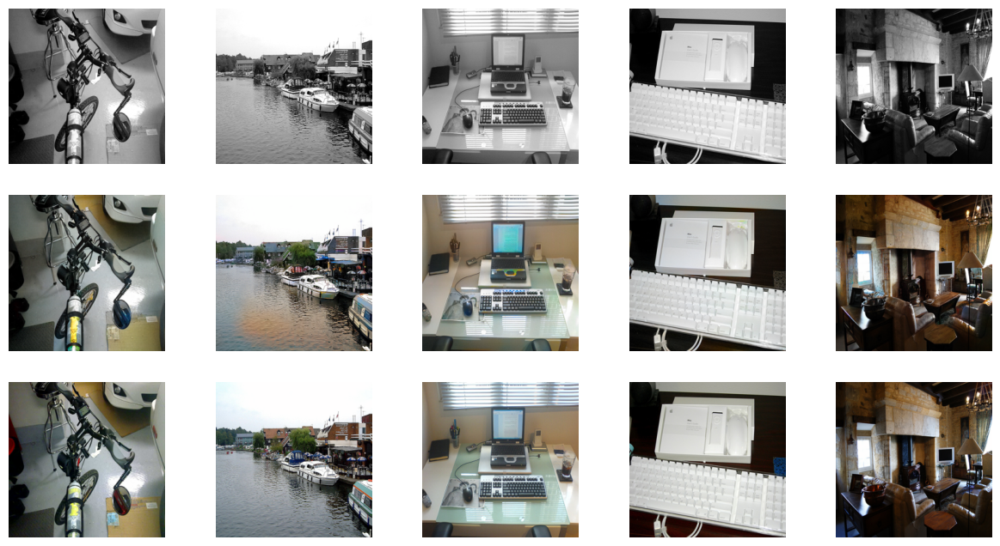


Epoch 16/20
Iteration 400/500
loss_D_fake: 0.61906
loss_D_real: 0.62280
loss_D: 0.62093
loss_G_GAN: 0.96307
loss_G_L1: 4.71349
loss_G: 5.67656


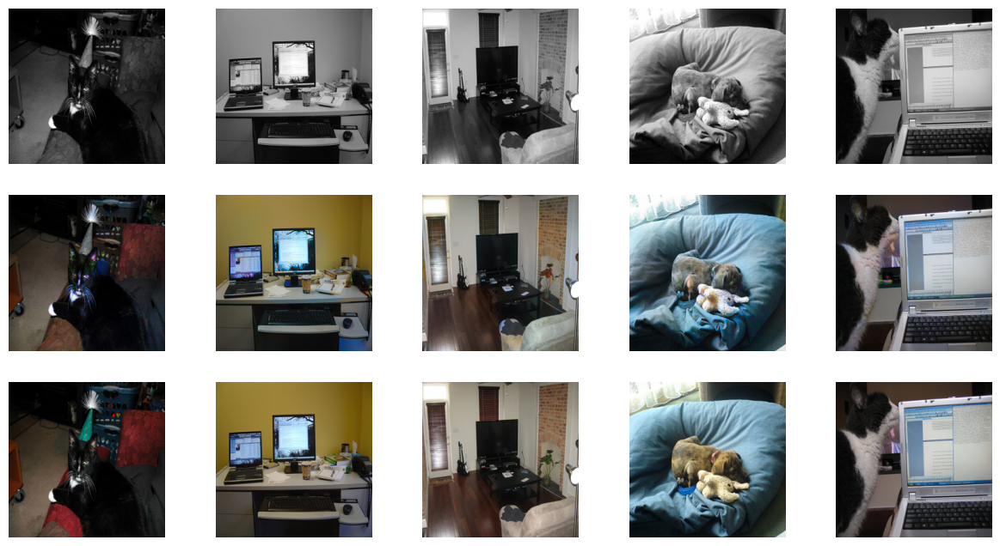

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 17/20
Iteration 200/500
loss_D_fake: 0.61766
loss_D_real: 0.62322
loss_D: 0.62044
loss_G_GAN: 0.96489
loss_G_L1: 4.66852
loss_G: 5.63341


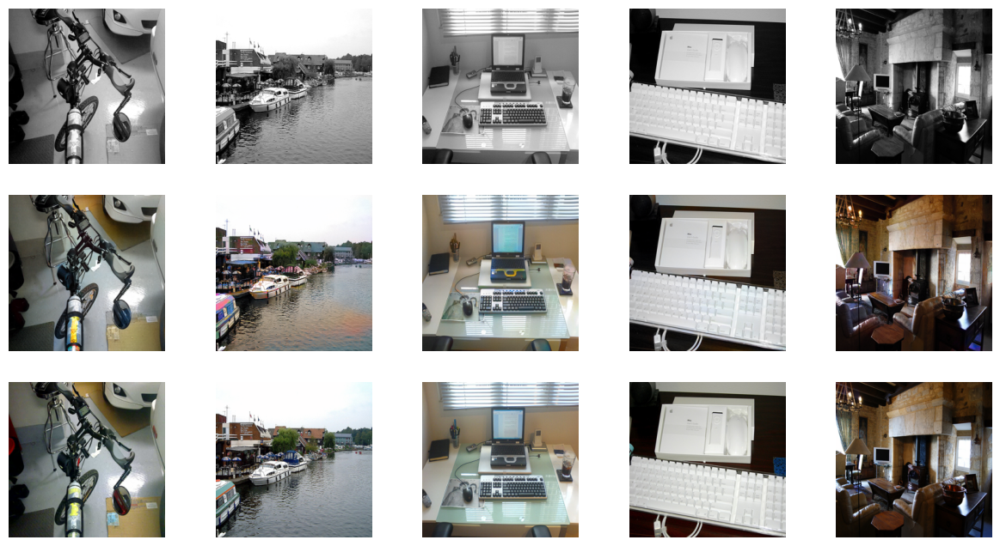


Epoch 17/20
Iteration 400/500
loss_D_fake: 0.66074
loss_D_real: 0.65506
loss_D: 0.65790
loss_G_GAN: 1.00359
loss_G_L1: 4.67632
loss_G: 5.67990


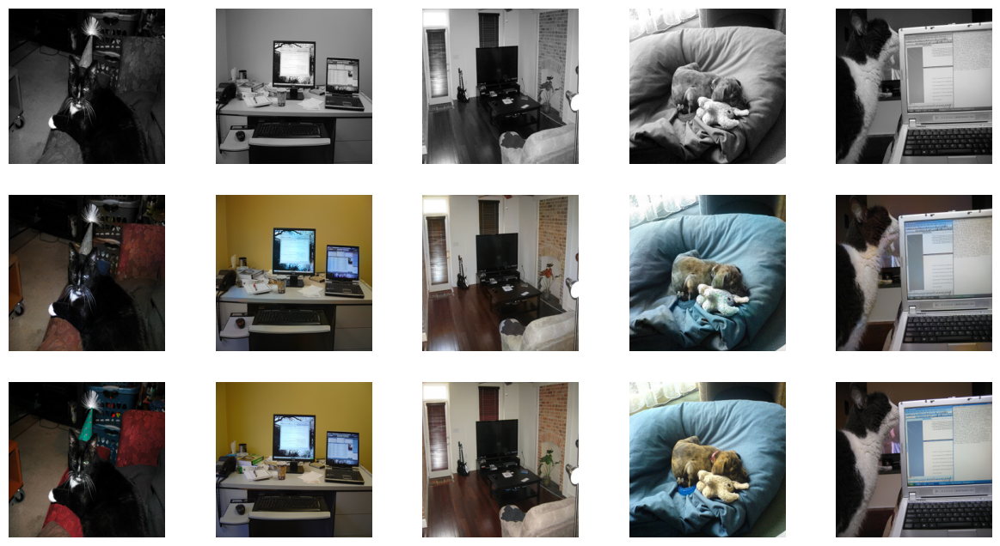

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 18/20
Iteration 200/500
loss_D_fake: 0.61407
loss_D_real: 0.61446
loss_D: 0.61427
loss_G_GAN: 0.92182
loss_G_L1: 4.63693
loss_G: 5.55875


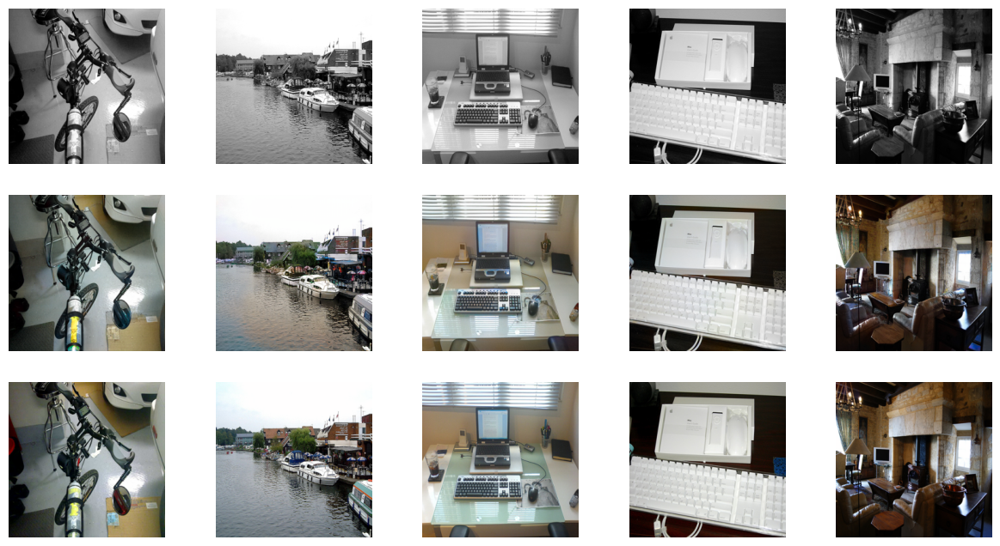


Epoch 18/20
Iteration 400/500
loss_D_fake: 0.61249
loss_D_real: 0.61380
loss_D: 0.61315
loss_G_GAN: 0.92393
loss_G_L1: 4.63917
loss_G: 5.56310


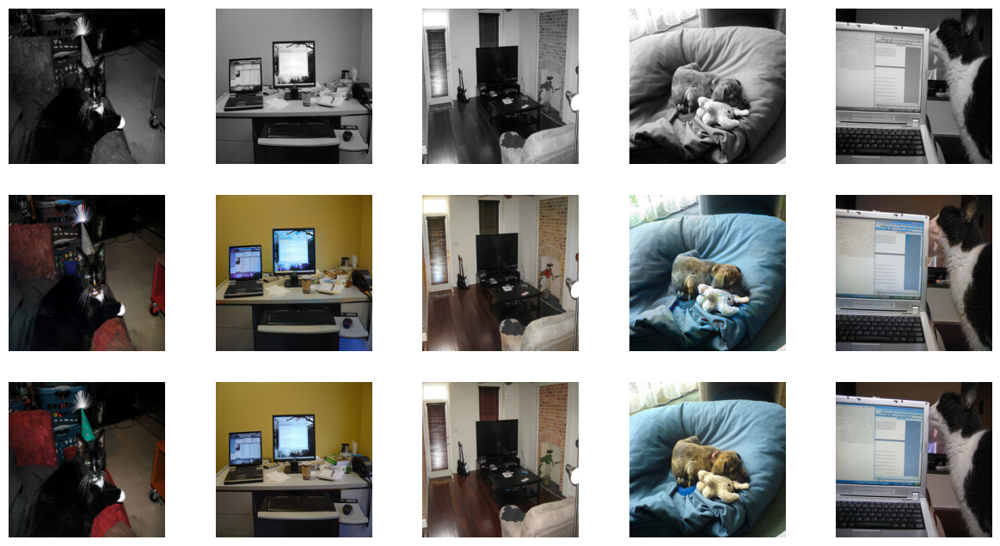

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 19/20
Iteration 200/500
loss_D_fake: 0.61676
loss_D_real: 0.61767
loss_D: 0.61722
loss_G_GAN: 0.95275
loss_G_L1: 4.58752
loss_G: 5.54028


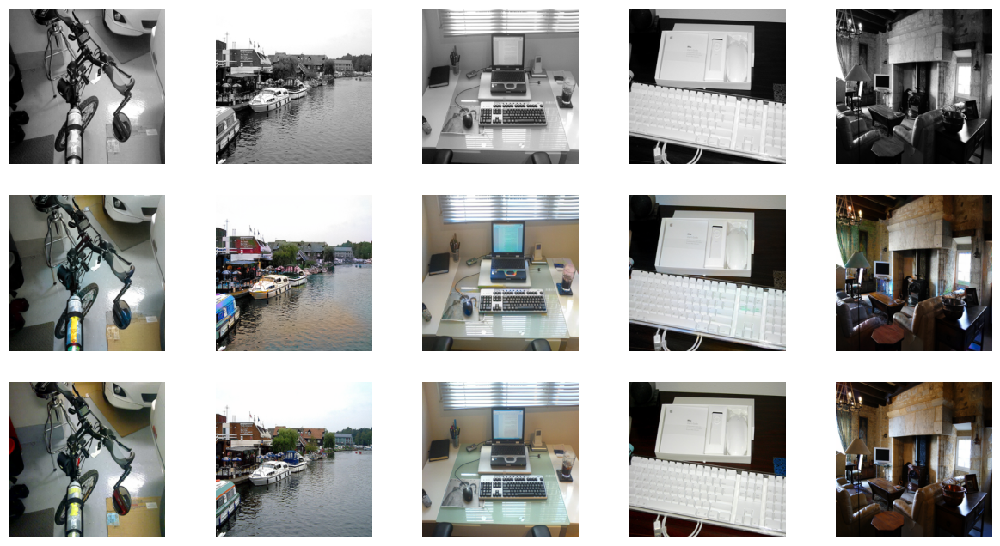


Epoch 19/20
Iteration 400/500
loss_D_fake: 0.61694
loss_D_real: 0.61811
loss_D: 0.61752
loss_G_GAN: 0.94868
loss_G_L1: 4.59987
loss_G: 5.54855


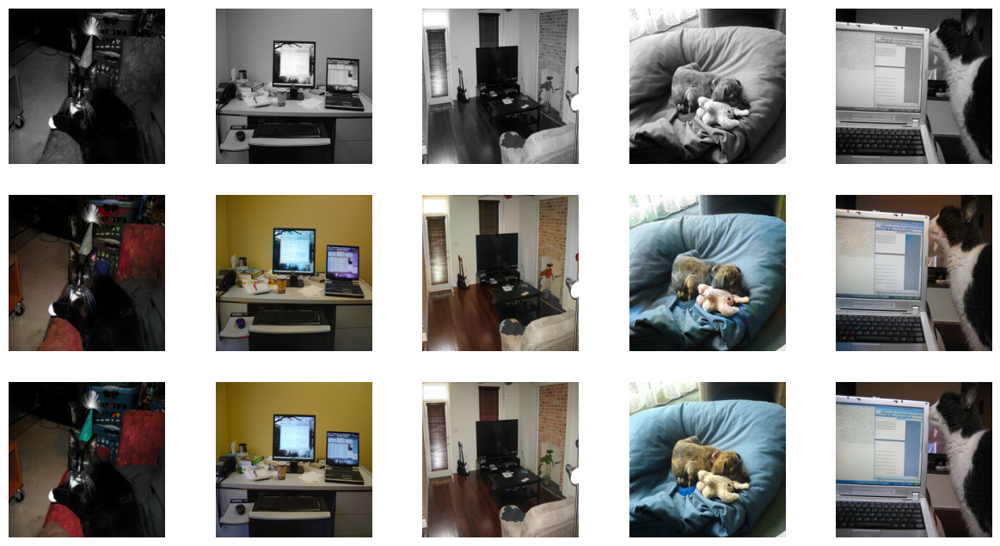

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 20/20
Iteration 200/500
loss_D_fake: 0.62237
loss_D_real: 0.62267
loss_D: 0.62252
loss_G_GAN: 0.95520
loss_G_L1: 4.57182
loss_G: 5.52701


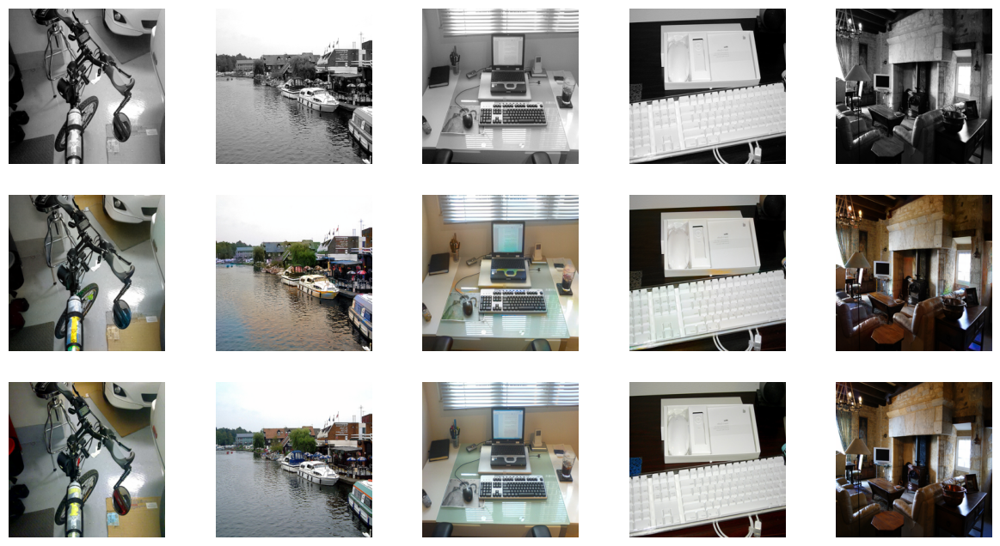


Epoch 20/20
Iteration 400/500
loss_D_fake: 0.61940
loss_D_real: 0.62171
loss_D: 0.62055
loss_G_GAN: 0.95074
loss_G_L1: 4.59663
loss_G: 5.54738


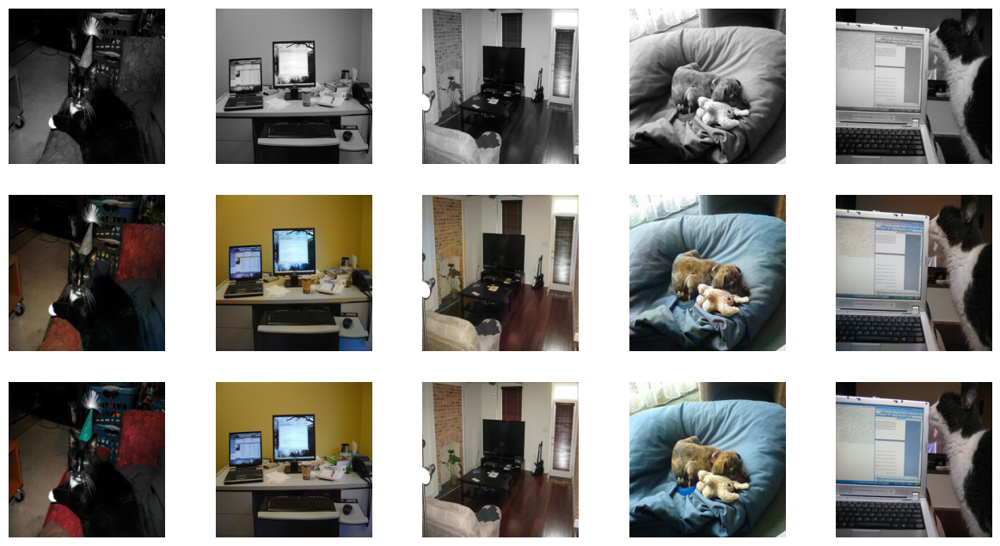

FileNotFoundError: ignored

In [ ]:
# from google.colab import files

net_G = build_res_unet_34(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res34-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
# torch.save(model.state_dict(), "test.pt")
model.load_state_dict(torch.load("final_v2.pt", map_location=device))
train_model(model, train_dl, 20)
torch.save(model.state_dict(), "final_v3.pt")

files.download('final_v3.pt')

The block to upload the image you want to colorize.

In [38]:
from google.colab import files
import shutil

# Upload an image file
uploaded = files.upload()

# Get the uploaded file name
file_name = next(iter(uploaded))

# Specify the target directory
target_directory = '/root/.fastai/data/coco_sample/train_sample/'

# Move the uploaded file to the target directory
shutil.move(file_name, target_directory)

# Print the new path of the moved file
new_path = os.path.join(target_directory, file_name)
print("File moved to:", new_path)

Saving intro_to_cs_test_image_2.jpg to intro_to_cs_test_image_2.jpg
File moved to: /root/.fastai/data/coco_sample/train_sample/intro_to_cs_test_image_2.jpg


In [39]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"

paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
train_paths = paths[:8000]
val_paths = paths[8000:10001]
count = 0;
for ele in paths:
  if ele == new_path:
    train_paths[0] = paths[count]
    break
  count += 1

print(train_paths)
train_paths = train_paths[0:16]

['/root/.fastai/data/coco_sample/train_sample/intro_to_cs_test_image_2.jpg', '/root/.fastai/data/coco_sample/train_sample/000000102987.jpg', '/root/.fastai/data/coco_sample/train_sample/000000075527.jpg', '/root/.fastai/data/coco_sample/train_sample/000000426118.jpg', '/root/.fastai/data/coco_sample/train_sample/000000437857.jpg', '/root/.fastai/data/coco_sample/train_sample/000000146614.jpg', '/root/.fastai/data/coco_sample/train_sample/000000258859.jpg', '/root/.fastai/data/coco_sample/train_sample/000000474049.jpg', '/root/.fastai/data/coco_sample/train_sample/000000451522.jpg', '/root/.fastai/data/coco_sample/train_sample/000000468276.jpg', '/root/.fastai/data/coco_sample/train_sample/000000138494.jpg', '/root/.fastai/data/coco_sample/train_sample/000000365282.jpg', '/root/.fastai/data/coco_sample/train_sample/000000346774.jpg', '/root/.fastai/data/coco_sample/train_sample/000000346049.jpg', '/root/.fastai/data/coco_sample/train_sample/000000400039.jpg', '/root/.fastai/data/coco_sa

In [40]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [41]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')
data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']

In [42]:
net_G = build_res_unet_34(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res34-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
model.load_state_dict(torch.load("final.pt", map_location=device))
visualize_model(model, train_dl,"G_pretrained_res34_result")

model initialized with norm initialization


  0%|          | 0/1 [00:00<?, ?it/s]

16
16
16


In [43]:
net_G = build_res_unet_34(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res34-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
model.load_state_dict(torch.load("final_v2.pt", map_location=device))
visualize_model(model, train_dl,"G_pretrained_res34_result")

model initialized with norm initialization


  0%|          | 0/1 [00:00<?, ?it/s]

16
16
16


In [44]:
net_G = build_res_unet_34(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res34-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
model.load_state_dict(torch.load("final_v3.pt", map_location=device))
visualize_model(model, train_dl,"G_pretrained_res34_result")

model initialized with norm initialization


  0%|          | 0/1 [00:00<?, ?it/s]

16
16
16


In [ ]:
!zip -r G_not_pretrained_vanilla.zip /content/G_not_pretrained_vanilla/*

updating: content/G_not_pretrained_vanilla/fake_colorized_0_1695296489.2561693.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_10_1695296489.7112694.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_11_1695296489.7639096.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_1_1695296489.3032944.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_12_1695296489.7988946.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_13_1695296489.8427577.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_14_1695296489.8876784.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_15_1695296489.9306986.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_2_1695296489.3486946.png (deflated 0%)
updating: content/G_not_pretrained_vanilla/fake_colorized_3_1695296489.3974779.png (deflated 0%)
updating: content/G_not_

In [ ]:
!zip -r G_pretrained_res18_result.zip /content/G_pretrained_res18_result/*

  adding: content/G_pretrained_res18_result/fake_colorized_0_1695297428.419321.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_10_1695297428.8480153.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_11_1695297428.8975673.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_1_1695297428.465878.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_12_1695297428.9330952.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_13_1695297428.9771047.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_14_1695297429.0220382.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_15_1695297429.0629797.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_2_1695297428.5058718.png (deflated 0%)
  adding: content/G_pretrained_res18_result/fake_colorized_3_1695297428.5470307.png (deflated 0%)
  adding: conten

In [ ]:
!zip -r G_pretrained_res34_result.zip /content/G_pretrained_res34_result/*

  adding: content/G_pretrained_res34_result/fake_colorized_0_1695299611.9598017.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_0_1695305431.6105342.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_10_1695299612.3880382.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_10_1695305432.0466716.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_11_1695299612.4369738.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_11_1695305432.0931158.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_1_1695299612.0052764.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_1_1695305431.6568356.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_12_1695299612.4720275.png (deflated 0%)
  adding: content/G_pretrained_res34_result/fake_colorized_12_1695305432.1279457.png (deflated 0%)
  adding: cont

!zip G_not_pretrained_vanilla.zip /content/G_not_pretrained_vanilla
!zip G_pretrained_res18_result.zip /content/G_pretrained_res18_result
!zip G_pretrained_res34_result.zip /content/G_pretrained_res34_result





## Diffusion Model

In [ ]:
path_color = '/root/.fastai/data/coco_sample/color/'
path_gray = '/root/.fastai/data/coco_sample/gray/'
path_flist = '/root/.fastai/data/coco_sample/flist/'
#seperate color/gray
if not os.path.exists(path_gray):
    os.mkdir(path_gray)
if not os.path.exists(path_color):
    os.mkdir(path_color)
dirs = os.listdir(coco_path)
for dir_item in dirs:
    image_file = Image.open(coco_path + '/' + dir_item)
    image_file.save(path_color + dir_item)
for dir_item in dirs:
		image_file = Image.open(path_color + dir_item) # open colour image
		image_file = image_file.convert('L') # convert image to black and white
		image_file.save(path_gray + dir_item)

#contruct flist
if not os.path.exists(path_flist):
    os.mkdir(path_flist)
fo = open(path_flist + 'train.flist', "w")
for item in train_paths:
    fo.write(item.split('/')[-1][:-4] + '\n')
fo.close()
fo = open(path_flist + 'test.flist', "w")
for item in val_paths:
    fo.write(item.split('/')[-1][:-4] + '\n')
fo.close()

color_paths = glob.glob(path_color + "*.jpg")
gray_paths = glob.glob(path_gray + "/*.jpg")
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), color_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), gray_paths):
    ax.imshow(Image.open(img_path), cmap='gray', vmin=0, vmax=255)
    ax.axis("off")

In [ ]:
!git clone https://github.com/xchwan/colorization_diffusion.git

In [ ]:
%cd colorization_diffusion

In [ ]:
!pip install -r requirements.txt

In [ ]:
!python run.py -p train -c config/colorization_mirflickr25k.json

In [ ]:
!zip -r train_0920_val.zip /content/colorization_diffusion/experiments/train_colorization_mirflickr25k_230919_154331/results

In [ ]:
!python run.py -p test -c config/colorization_mirflickr25k.json